In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
np.random.seed(47)
import random
random.seed(47)
import cv2 as cv
import os
import h5py
import math
from pathlib import Path
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

In [ ]:
def show_FDD_video_annotated(video_path, annotation_path):
    ''' Display FDD video with annotated bounding box and labels '''
    video = cv.VideoCapture(video_path)
    if (not video.isOpened()):
        print("{} cannot be opened".format(video_path))
        return False

    if (not os.path.isfile(annotation_path)):
        print("{} is not a valid file").format(annotation_path)
        return False

    annotation_file = open(annotation_path, "r")
    fall_start = int(annotation_file.readline())
    fall_end = int(annotation_file.readline())

    font = cv.FONT_HERSHEY_SIMPLEX
    green = (0, 255, 0)
    red = (0, 0, 255)
    orange = (0, 127, 255)
    line_type = cv.LINE_AA

    while True:
        ret, frame = video.read()
        if not ret:
            break

        annotations = annotation_file.readline().strip().split(",")
        frame_num = int(annotations[0])
        label = int(annotations[1])
        label_text = ""
        color = (255, 255, 255)
        if ((fall_start == fall_end and fall_start == 0) or label == 1 or frame_num < fall_start):
            label_text = "No fall"
            color = green
        elif (fall_start <= frame_num <= fall_end):
            label_text = "Falling"
            color = red
        elif (frame_num > fall_end):
            label_text = "Fallen"
            color = orange

        x_start = int(annotations[2])
        y_start = int(annotations[3])
        x_end = int(annotations[4])
        y_end = int(annotations[5])

        frame = cv.putText(
            frame, "Frame: {}".format(frame_num), (5, 20),
            fontFace = font, fontScale = 0.5, color = color, lineType = line_type
        )
        frame = cv.putText(
            frame, "Label: {}".format(label_text), (5, 40),
            fontFace = font, fontScale = 0.5, color = color, lineType = line_type
        )
        frame = cv.rectangle(
            frame, (x_start, y_start), (x_end, y_end),
            color = color, lineType = line_type
        )
        cv2_imshow(frame)
        if cv.waitKey(30) == 27:
            break

    video.release()
    cv.destroyAllWindows()
    return True

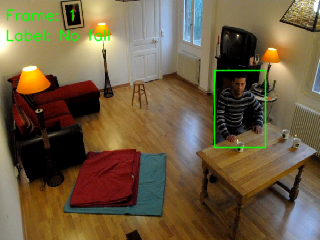

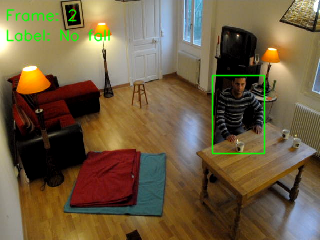

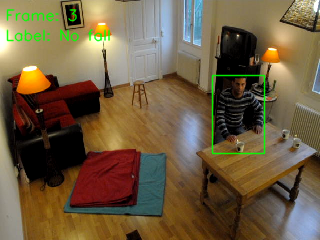

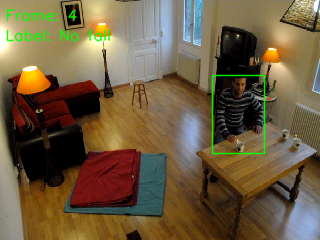

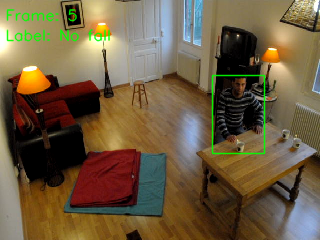

...

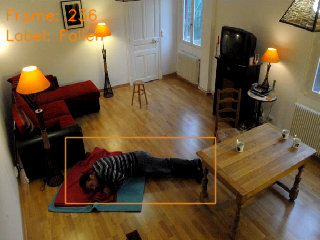

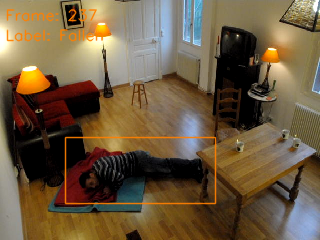

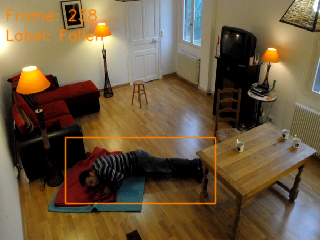

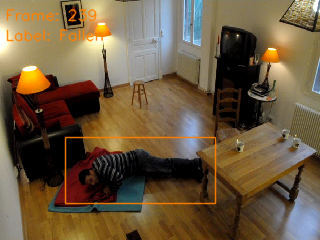

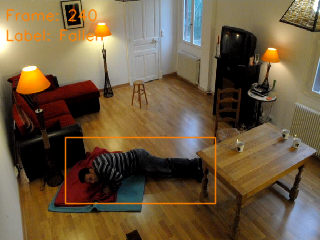

True

In [ ]:
video_path = './drive/MyDrive/dataset/Home_01/Home_01/Videos/video (2).avi'
annotation_path = './drive/MyDrive/dataset/Home_01/Home_01/Annotation_files/video (2).txt'
show_FDD_video_annotated(video_path, annotation_path)

In [ ]:
# def create_cropped_FDD(image_size = 224):
#     ''' Crop out bounding box from each frame for each video in FDD '''
#     dataset_path = "/content/drive/MyDrive/dataset/"
#     folders = ["Coffee_room_01"]
#     base_save_path = "/content/drive/MyDrive/dataset/RGB/"
#     Path(base_save_path).mkdir(parents = True, exist_ok = True)
#     IMAGE_EXT = ".jpg"

#     for folder_name in folders:
#         folder_path = dataset_path + folder_name + "/"+ folder_name + "/"
#         video_folder_path = folder_path + "Videos/"
#         annotation_folder_path = folder_path + "Annotation_files/"

#         video_names = os.listdir(video_folder_path)

#         for video_name in video_names:
#             video_path = video_folder_path + video_name
#             video_name_no_ext = video_name.split('.')[0]
#             save_path = base_save_path + folder_name + "/" + video_name_no_ext + "/"
#             annotation_path = annotation_folder_path + video_name_no_ext + ".txt"



# # tách
#             annotation_file = open(annotation_path, "r")
#             fall_start = int(annotation_file.readline())
#             fall_end = int(annotation_file.readline())

#             save_path = base_save_path + folder_name + "/" + video_name_no_ext + "/"
#             Path(save_path).mkdir(parents = True, exist_ok = True)
#             video = cv.VideoCapture(video_path)
#             if (not video.isOpened()):
#                 print("{} cannot be opened".format(video_path))
#                 return False
#             while True:
#                 ret, frame = video.read()
#                 if not ret:
#                     break
#                 annotations = annotation_file.readline().strip().split(",")
#                 img_save_path = save_path + annotations[0] + IMAGE_EXT
#                 x_start = int(annotations[2])
#                 y_start = int(annotations[3])
#                 x_end = int(annotations[4])
#                 y_end = int(annotations[5])
#                 if (x_start == 0 and y_start == 0 and x_end == 0 and y_end == 0):
#                     x_start = 0
#                     y_start = 0
#                     x_end = frame.shape[0]
#                     y_end = frame.shape[1]

#                 cropped = frame[y_start:y_end, x_start:x_end].copy()
#                 try:
#                     cropped = cv.resize(cropped, (image_size, image_size), interpolation = cv.INTER_LINEAR)
#                     if not cv.imwrite(img_save_path, cropped):
#                         print("Cannot write to {}".format(img_save_path))
#                 except:
#                     print("Something wrong with {}/{}. Saving original frame instead".format(folder_name, video_name))
#                     frame = cv.resize(frame, (image_size, image_size), interpolation = cv.INTER_LINEAR)
#                     if not  cv.imwrite(img_save_path, frame):
#                         print("Cannot write to {}".format(img_save_path))
#             video.release()

In [ ]:
def create_cropped_FDD_from_video(video_path,folder_name, annotation_path, save_path, image_size = 224):
  IMAGE_EXT = '.jpg'
  annotation_file = open(annotation_path, "r")
  fall_start = int(annotation_file.readline())
  fall_end = int(annotation_file.readline())

  video_name, _ = os.path.splitext(os.path.basename(video_path))
  Path(save_path).mkdir(parents = True, exist_ok = True)

  video = cv.VideoCapture(video_path)
  if (not video.isOpened()):
      print("{} cannot be opened".format(video_path))
      return False
  while True:
      ret, frame = video.read()
      if not ret:
          break
      annotations = annotation_file.readline().strip().split(",")
      img_save_path = save_path + annotations[0] + IMAGE_EXT
      x_start = int(annotations[2])
      y_start = int(annotations[3])
      x_end = int(annotations[4])
      y_end = int(annotations[5])
      if (x_start == 0 and y_start == 0 and x_end == 0 and y_end == 0):
          x_start = 0
          y_start = 0
          x_end = frame.shape[0]
          y_end = frame.shape[1]

      cropped = frame[y_start:y_end, x_start:x_end].copy()
      try:
          cropped = cv.resize(cropped, (image_size, image_size), interpolation = cv.INTER_LINEAR)
          if not cv.imwrite(img_save_path, cropped):
              print("Cannot write to {}".format(img_save_path))
      except:
          print("Something wrong with {}/{}. Saving original frame instead".format(folder_name, video_name))
          frame = cv.resize(frame, (image_size, image_size), interpolation = cv.INTER_LINEAR)
          if not  cv.imwrite(img_save_path, frame):
              print("Cannot write to {}".format(img_save_path))
  video.release()

In [ ]:
#funtion capture RGB images have loop
def create_cropped_FDD(image_size = 224):
    ''' Crop out bounding box from each frame for each video in FDD '''
    dataset_path = "/content/drive/MyDrive/dataset/"
    folders = ["Home_02"]
    base_save_path = "/content/drive/MyDrive/dataset/RGB/"
    Path(base_save_path).mkdir(parents = True, exist_ok = True)
    IMAGE_EXT = ".jpg"

    for folder_name in folders:
        folder_path = dataset_path + folder_name + "/"+ folder_name + "/"
        video_folder_path = folder_path + "Videos/"
        annotation_folder_path = folder_path + "Annotation_files/"

        video_names = os.listdir(video_folder_path)

        for video_name in video_names:
            video_path = video_folder_path + video_name
            video_name_no_ext = video_name.split('.')[0]
            save_path = base_save_path + folder_name + "/" + video_name_no_ext + "/"
            annotation_path = annotation_folder_path + video_name_no_ext + ".txt"
            create_cropped_FDD_from_video(video_path, folder_name,annotation_path, save_path, image_size)

In [ ]:
create_cropped_FDD()

In [ ]:
def create_MHI_from_video(video_path, save_path, image_size):
    ''' Each frame is compared not to the frame right before it, but to the frame
        that is a few frames before as determined by the variable 'interval',
        of which value varies with the FPS of the video. The higher the FPS,
        the larger the interval.
    '''
    if (not os.path.isfile(video_path)):
        print("{} is not a valid file".format(video_path))
        return False

    video = cv.VideoCapture(video_path)
    if (not video.isOpened()):
        print("{} cannot be opened".format(video_path))
        return False

    video_name, _ = os.path.splitext(os.path.basename(video_path))
    if (save_path[len(save_path) - 1] != "/"):
        save_path += "/"
    try:
        Path(save_path).mkdir(parents = True, exist_ok = True)
    except:
        print("Cannot create directory {}".format(save_path))
        return False

    MHI_DURATION = 1500 # milliseconds
    THRESHOLD = 32
    GAUSSIAN_KERNEL = (3, 3)
    IMAGE_EXT = ".jpg"

    fps = video.get(cv.CAP_PROP_FPS)
    interval = int(max(1, math.ceil(fps/10) if (fps/10 - math.floor(fps/10)) >= 0.5 else math.floor(fps/10)))
    ms_per_frame = 1000 / fps # milliseconds

    prev_frames = [None] * interval
    prev_mhi = [None] * interval
    prev_timestamp = [None] * interval
    for i in range(interval):
        ret, frame = video.read()
        frame = cv.resize(frame, (image_size, image_size), interpolation = cv.INTER_AREA)
        frame = cv.GaussianBlur(frame, GAUSSIAN_KERNEL, 0)
        prev_frames[i] = frame.copy()
        prev_mhi[i] = np.zeros((image_size, image_size), np.float32)
        prev_timestamp[i] = i * ms_per_frame

    count = interval
    while True:
        ret, frame = video.read()
        if ret == False:
            break

        prev_ind = count % interval
        prev_timestamp[prev_ind] += interval * ms_per_frame
        count += 1

        frame = cv.resize(frame, (image_size, image_size), interpolation = cv.INTER_AREA)
        frame = cv.GaussianBlur(frame, GAUSSIAN_KERNEL, 0)
        frame_diff = cv.absdiff(frame, prev_frames[prev_ind])
        gray_diff = cv.cvtColor(frame_diff, cv.COLOR_BGR2GRAY)
        _, motion_mask = cv.threshold(gray_diff, THRESHOLD, 1, cv.THRESH_BINARY)

        cv.motempl.updateMotionHistory(motion_mask, prev_mhi[prev_ind], prev_timestamp[prev_ind], MHI_DURATION)
        mhi = np.uint8(np.clip((prev_mhi[prev_ind] - (prev_timestamp[prev_ind] - MHI_DURATION))/MHI_DURATION, 0, 1) * 255)
        cv.imwrite("{}{}{}".format(save_path, count, IMAGE_EXT), mhi)
        prev_frames[prev_ind] = frame.copy()

    video.release()

In [ ]:
def create_MHI_FDD(image_size = 224):
    ''' Create MHI for each video in FDD '''
    dataset_path = "/content/drive/MyDrive/dataset/"
    folders = ["Home_02"]
    base_save_path = "/content/drive/MyDrive/dataset/MHI/"
    Path(base_save_path).mkdir(parents = True, exist_ok = True)

    for folder_name in folders:
        folder_path = dataset_path + folder_name + "/" + folder_name + "/"
        video_folder_path = folder_path + "Videos/"
        video_names = os.listdir(video_folder_path)

        for video_name in video_names:
            video_path = video_folder_path + video_name
            save_path = base_save_path + folder_name + "/" + video_name.strip().split(".")[0] + "/"
            create_MHI_from_video(video_path, save_path, image_size)

In [ ]:
# video_path = "/content/drive/MyDrive/dataset/Coffee_room_02/Coffee_room_02/Videos/video (53).avi"
# save_path = "/content/drive/MyDrive/dataset/MHI/Coffee_room_02/video (53)/"
# image_size = 224
# create_MHI_from_video(video_path, save_path, image_size)

In [ ]:
create_MHI_FDD()

In [ ]:
def create_two_stream_dataset_FDD():
    ''' A rather long and unwieldy function to combine RGB and MHI and split
        into train/validation/test set. The final dataset is saved as a .hdf5
    '''
    dataset_path = "/content/drive/MyDrive/dataset/"
    folder_names = ["Coffee_room_01","Coffee_room_01","Home_01","Home_02"]

    train_percent = 0.7
    cv_percent = 0.2
    precision = 0.01
    START_OFFSET = 2 # How many of the first fall frames to skip
    END_OFFSET = 0 # How many of the last fall frames to skip

    total_fall_frames = 0
    video_map = {}
    video_falls = []
    video_no_falls = []
    video_fall_map = {}
    train_fall_videos = []
    val_fall_videos = []
    test_fall_videos = []

    for folder in folder_names:
        annotation = dataset_path + folder + "/" + folder + "/Annotation_files/"
        video_annots = os.listdir(annotation)
        print(video_annots)
        for video_annot in video_annots:
            video_name = video_annot.split('.')[0]
            annotation_path = annotation + video_annot

            annotation_file = open(annotation_path, "r")
            print(video_annot)
            start_fall = int(annotation_file.readline())
            end_fall = int(annotation_file.readline())

            # Tính số frame ngã trong một video
            fall_frames = end_fall - start_fall - START_OFFSET - END_OFFSET
            video_map[(folder, video_name)] = (start_fall, end_fall, fall_frames)
            if (start_fall == 0 and end_fall == 0):
                video_no_falls.append((folder, video_name))
                continue
            if (fall_frames > 0):
                video_fall_map[(folder, video_name)] = (start_fall, end_fall, fall_frames)
                video_falls.append(((folder, video_name), fall_frames))
                total_fall_frames += fall_frames

    video_fall_count = len(video_falls)
    while True:
        train_count = 0
        cv_count = 0
        video_index = [i for i in range(video_fall_count)]
        random.shuffle(video_index)
        cv_start_index = 0
        test_start_index = 0
        found_train = False
        found_cv = False
        no_motion_prob = 0.75

        # chọn 70% cho tập train
        for i in range(video_fall_count):
            index = video_index[i]
            train_count += video_falls[index][1]
            abs_value = abs(train_count/total_fall_frames - train_percent)
            # print("i = ", i)
            # print("Abs value: ", abs_value)
            if abs_value < precision:
                cv_start_index = i + 1
                found_train = True
                break
        if not found_train:
            continue


        # chọn 20% cho tập validate
        for i in range(cv_start_index, video_fall_count):
            index = video_index[i]
            cv_count += video_falls[index][1]
            abs_value = abs(cv_count/total_fall_frames - cv_percent)
            # print("i = ", i)
            # print("Abs value: ", abs_value)
            if abs_value < precision:
                test_start_index = i + 1
                found_cv = True
                break
        if not found_cv:
            continue

        for i in range(cv_start_index):
            index = video_index[i]
            train_fall_videos.append(video_falls[index][0])

        for i in range(cv_start_index, test_start_index):
            index = video_index[i]
            val_fall_videos.append(video_falls[index][0])

        for i in range(test_start_index, video_fall_count):
            index = video_index[i]
            test_fall_videos.append(video_falls[index][0])

        break

    fall_split_map = { "train": train_fall_videos, "val": val_fall_videos, "test": test_fall_videos }
    data_map = {
        "rgb": { "train": [], "val": [], "test": [] },
        "mhi": { "train": [], "val": [], "test": [] }
    }
    label_map = { "train": [], "val": [], "test": []}
    IMAGE_EXT = ".jpg"
    total_fall_frame_added = 0
    total_no_fall_frame_added = 0

    for key, videos in fall_split_map.items():
        print("Adding falls - " + key)
        for video in videos:
            start_fall, end_fall, fall_count = video_fall_map[video]
            mhi_folder_path = dataset_path + "MHI/" + video[0] + "/" + video[1] + "/"
            rgb_folder_path = dataset_path + "RGB/" + video[0] + "/" + video[1] + "/"
            # final_frame = min(len(os.listdir(mhi_folder_path)), len(os.listdir(rgb_folder_path)))
            final_frame = 3 + len(os.listdir(mhi_folder_path))
            print("Final frame: ", final_frame)

            # Add falls
            fall_frame_added = 0
            for i in range(start_fall + START_OFFSET + 1, end_fall - END_OFFSET + 1):
                mhi_path = mhi_folder_path + str(i) + IMAGE_EXT
                rgb_path = rgb_folder_path + str(i) + IMAGE_EXT

                mhi = cv.imread(mhi_path)
                rgb = cv.imread(rgb_path) # BGR format
                rgb = cv.cvtColor(rgb, cv.COLOR_BGR2RGB) # convert to RGB
                data_map["mhi"][key].append(mhi)
                data_map["rgb"][key].append(rgb)
                label_map[key].append(1)

                # Flip horizontally
                mhi = cv.flip(mhi, 0)
                rgb = cv.flip(rgb, 0)
                data_map["mhi"][key].append(mhi)
                data_map["rgb"][key].append(rgb)
                label_map[key].append(1)

                total_fall_frame_added += 2 # Unflipped and flipped
                fall_frame_added += 1 # Just unflipped

            # Add no falls
            no_fall_indices = [i for i in range(4, start_fall - 3)] + [i for i in range(end_fall + 3, final_frame)]
            while fall_frame_added > 0 and len(no_fall_indices) > 0:
                frame_num = random.choice(no_fall_indices)
                print("Frame num: ", frame_num)
                mhi_path = mhi_folder_path + str(frame_num) + IMAGE_EXT
                print(mhi_path)
                mhi = cv.imread(mhi_path)
                isSingleValue = True
                for i in range(mhi.shape[1]):
                    for j in range(mhi.shape[0]):
                        if (i == 0 and j == 0):
                            continue
                        if mhi[i, j, 0] != mhi[0, 0, 0]:
                            isSingleValue = False
                            break
                    if not isSingleValue:
                        break
                if isSingleValue and random.random() < no_motion_prob:
                    continue

                rgb_path = rgb_folder_path + str(frame_num) + IMAGE_EXT
                try:
                  rgb = cv.imread(rgb_path)
                  rgb = cv.cvtColor(rgb, cv.COLOR_BGR2RGB)
                except:
                  print("Error loading image:", rgb_path)
                  return
                data_map["mhi"][key].append(mhi)
                data_map["rgb"][key].append(rgb)
                label_map[key].append(0)
                no_fall_indices.remove(frame_num)
                total_no_fall_frame_added += 1
                fall_frame_added -= 1



    # Add no fall in no fall videos
    no_fall_video_num = len(video_no_falls)
    avg_frame_num = math.ceil((total_fall_frame_added - total_no_fall_frame_added) / no_fall_video_num)
    cv_no_fall_start_ind = math.ceil(no_fall_video_num * 0.7)
    test_no_fall_start_ind = math.ceil(no_fall_video_num * 0.9)
    random.shuffle(video_no_falls)
    no_fall_split_map = {
        "train": video_no_falls[:cv_no_fall_start_ind],
        "val": video_no_falls[cv_no_fall_start_ind:test_no_fall_start_ind],
        "test": video_no_falls[test_no_fall_start_ind:]
    }

    for key, videos in no_fall_split_map.items():
        print("Adding no falls in no fall videos - " + key)
        for video in videos:
            mhi_folder_path = dataset_path + "MHI/" + video[0] + "/" + video[1] + "/"
            rgb_folder_path = dataset_path + "RGB/" + video[0] + "/" + video[1] + "/"
            no_fall_frame_added = 0
            # frame_indices = [i for i in range(4, min(len(os.listdir(mhi_folder_path)), len(os.listdir(rgb_folder_path))) + 1)]
            frame_indices = [i for i in range(4, len(os.listdir(mhi_folder_path)) + 1)]

            while no_fall_frame_added < avg_frame_num and len(frame_indices) > 0:
                frame_num = random.choice(frame_indices)
                print("Frame num: ", frame_num)
                mhi_path = mhi_folder_path + str(frame_num) + IMAGE_EXT
                mhi = cv.imread(mhi_path)
                isSingleValue = True
                for i in range(mhi.shape[1]):
                    for j in range(mhi.shape[0]):
                        if (i == 0 and j == 0):
                            continue
                        if mhi[i, j, 0] != mhi[0, 0, 0]:
                            isSingleValue = False
                            break
                    if not isSingleValue:
                        break
                if isSingleValue and random.random() < no_motion_prob:
                    continue

                rgb_path = rgb_folder_path + str(frame_num) + IMAGE_EXT
                rgb = cv.imread(rgb_path)
                rgb = cv.cvtColor(rgb, cv.COLOR_BGR2RGB)
                data_map["mhi"][key].append(mhi)
                data_map["rgb"][key].append(rgb)
                label_map[key].append(0)
                frame_indices.remove(frame_num)
                no_fall_frame_added += 1

    return data_map, label_map


In [ ]:
data_map, label_map = create_two_stream_dataset_FDD()

Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
Frame num:  208
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/208.jpg
Frame num:  55
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/55.jpg
Frame num:  91
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/91.jpg
Frame num:  8
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/8.jpg
Frame num:  90
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/90.jpg
Frame num:  16
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/16.jpg
Frame num:  194
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/194.jpg
Frame num:  80
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/80.jpg
Frame num:  29
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/29.jpg
Frame num:  31
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/31.jpg
Frame num:  260
/content/drive/MyDrive/dataset/MHI/Coffee_room_01/video (25)/260.jpg
Frame num:  115
/content/d

In [ ]:
def save_file_dataset(data_map, label_map):
  with h5py.File("/content/drive/MyDrive/dataset/FDD/fdd.hdf5", "w") as save_file:
        data_group = save_file.create_group("data")
        for type, map in data_map.items():
            type_group = data_group.create_group(type)
            for key, data in map.items():
                type_group.create_dataset(key, data = np.array(data, dtype = np.uint8))

        label_group = save_file.create_group("labels")
        for key, labels in label_map.items():
            label_group.create_dataset(key, data = np.array(labels, dtype = np.uint8))

In [ ]:
save_file_dataset(data_map, label_map)